<a href="https://colab.research.google.com/github/madnap0502/Relatividad/blob/main/No2_Cap1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Consecuencias de la transformación de Lorentz**

Las transformaciones de Lorentz, son la base matematica de la relatividad especial, las cuales replantean conceptos clásicos como el tiempo y el espacio y para comprenderlo, se examinan tres aspectos clave: como la medición del ritmo de un reloj, la longitud de un objeto y la simultaneidad de eventos entre observadores inerciales.

Estos fenómenos requieren definir cada concepto mediante **intervalos entre eventos**, lo que asegura coherencia entre marcos de referencia, por lo que gracias a este enfoque, las reglas de transformación permiten relacionar mediciones en distintos sistemas, que en consecuencia, surgen efectos como la **dilatación temporal** y **la contracción espacial**, demostrando así que las mediciones físicas dependen intrínsecamente del marco del observador.Cuyos conceptos seran explicados y explorados en este notebook

In [1]:
!pip install -Uq ipywidgets
!pip install -Uq scipy
!pip install -Uq gdown




[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\Cari0502\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\Cari0502\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\Cari0502\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import gdown
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Circle, Arrow
import matplotlib.gridspec as gridspec
from IPython.display import HTML, display
import ipywidgets as widgets
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import matplotlib.patches as patches
from scipy import constants as const
import matplotlib.image as mpimg

## **1.3.1 Dilatación del Tiempo**

Uno de los fenómenos más notables de la relatividad especial es la **dilatación temporal**, la cual demuestra que el tiempo transcurre a ritmos distintos para observadores en movimiento relativo. Para comprender este fenómeno, analicemos el caso de una partícula subatómica inestable, como un muón, cuya vida media se mide en dos marcos inerciales: el **marco de laboratorio $S$** y el **marco de reposo de la partícula $S'$**.  

* **En el marco $S'$ en reposo (marco del observador que se mueve con la particula):**

  La partícula está inmóvil, por lo que su creación (evento 1) y desintegración (evento 2) ocurren en la misma posición espacial $x'$. El intervalo temporal entre estos eventos se denomina **tiempo propio** $(\Delta \tau)$,que está definido como:

  $$
  \Delta \tau = t'_2 - t'_1 \quad \text{y} \quad \Delta x' = 0.
  $$  

  Este es el tiempo más corto posible entre los dos eventos, ya que no hay desplazamiento espacial.  

* **En el marco $S$ (fijo en el laboratorio):**

   La partícula se mueve a velocidad constante $V$ en dirección $x$ y aquí, los eventos 1 y 2 ocurren en posiciones distintas ($x_1 \neq x_2$), y el tiempo medido ($\Delta T$) incluye un intervalo espacial ($\Delta x = x_2 - x_1$).  

Las coordenadas de los eventos en ambos marcos se relacionan mediante las **transformaciones de Lorentz**, por medio de la definición de los intervalos(explicado en el notebook anterior No_1_Cap1.ipynb), se tiene en cuenta el intervalo del tiempo:

$$
\Delta t = \gamma(V) \left( \Delta t' + \frac{V \Delta x'}{c^2} \right),
(\Delta t' = \Delta \tau)
$$  
donde $\gamma(V)$ es el **factor de Lorentz**:  
$$
\gamma(V) = \frac{1}{\sqrt{1 - V^2/c^2}} \quad (\gamma > 1 \text{ si } V > 0).
$$

Como en $S'$ no hay desplazamiento espacial $(\Delta x' = 0)$, la ecuación se simplifica a:  
$$
\Delta T = \gamma(V) \Delta \tau.
$$  
Esto muestra que el tiempo medido en el laboratorio $\Delta T$ es mayor que el tiempo propio $\Delta \tau$, ya que $\gamma(V)$ amplifica el intervalo.

En conclusión,Un proceso que dura un intervalo de tiempo propio $\Delta \tau $ en su propio sistema de referencia en reposo tendrá una mayor duración $\Delta T$ cuando se observa desde otro sistema que se mueve con respecto al primero. Por ejemplo, si el proceso corresponde al tic-tac de un reloj, entonces una consecuencia es que los relojes en movimiento se observarán como si marcharan más lentamente.

Los muones, son partículas creadas en la atmósfera por los rayos cósmicos y tienen una vida media de ~2.2 μs en su marco de reposo. Sin embargo, en la Tierra (marco S), se detectan en mayor cantidad de lo esperado porque, debido a que van con velocidades cercanas a la de la luz $(V \approx 0.99c$), su vida media se dilata $(\Delta T \approx 15.6 \mu s$), lo que permite que alcancen la superficie terrestre, confirmando experimentalmente la dilatación temporal.  

In [3]:
# Parámetros físicos
vel = 0.99  # v/c
gamma = 1/np.sqrt(1 - vel**2)  # Factor de Lorentz
tiempo_reposo = 2.2  # Vida media en marco de reposo (μs)
tiempo_lab = tiempo_reposo*gamma  # Vida media dilatada (μs)

print(f"Factor gamma: {gamma:.2f}")
print(f"Vida media en reposo: {tiempo_reposo} μs")
print(f"Vida media dilatada: {tiempo_lab:.2f} μs")

# Configuración de la figura
fig = plt.figure(figsize=(12, 6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

# Subplots para cada marco de referencia
ax1 = plt.subplot(gs[0])  # Marco S' (Reposo del muón)
ax2 = plt.subplot(gs[1])  # Marco S (Laboratorio)

ax1.set_xlim(-5, 5)
ax1.set_ylim(-5, 5)
ax1.set_aspect('equal')
ax1.set_title("Marco S' - Reposo del muón\nTiempo propio")
ax1.axis('off')

ax2.set_xlim(-5, 5)
ax2.set_ylim(-5, 5)
ax2.set_aspect('equal')
ax2.set_title("Marco S - Laboratorio \nTiempo dilatado")
ax2.axis('off')

# Crear círculos para representar los muones
muon_reposo = Circle((0, 0), 2, color='purple', alpha=0.7)
muon_dilatado = Circle((0, 0), 2, color='deeppink', alpha=0.7)

ax1.add_patch(muon_reposo)
ax2.add_patch(muon_dilatado)

# Textos de tiempo
texto_tiempo_reposo = ax1.text(0.05, 0.95, '', transform=ax1.transAxes, fontsize=12)
texto_tiempo_dilatado = ax2.text(0.05, 0.95, '', transform=ax2.transAxes, fontsize=12)

# Esta es la clave: establecemos la misma duración total para la animación (en frames),
# pero el muón en S' se encoge γ veces más rápido que el muón en S
max_frames = 250
frame_muon_reposo = int(max_frames/gamma)  # Frame en el que se desintegra el muón en reposo

# Información sobre la vida máxima para calcular el porcentaje
duracion_muon_reposo = tiempo_reposo
duracion_muon_lab = tiempo_lab

# Variables para controlar si se ha mostrado el mensaje "Desintegrado"
texto1_added = False
texto2_added = False

def init():
    global text1_added, text2_added
    texto1_added = False
    texto2_added = False
    muon_reposo.set_radius(2)
    muon_dilatado.set_radius(2)
    texto_tiempo_reposo.set_text('')
    texto_tiempo_dilatado.set_text('')
    return muon_reposo, muon_dilatado, texto_tiempo_reposo, texto_tiempo_dilatado

def update(frame):
    global texto1_added, texto2_added

    # Calculamos los tiempos correspondientes en cada marco
    # El tiempo en S' avanza más rápido que en S (por un factor gamma)
    tiempo_reposo_ani = frame*(duracion_muon_reposo/frame_muon_reposo) if frame <= frame_muon_reposo else duracion_muon_reposo
    tiempo_dilatado_ani = frame*(duracion_muon_lab/max_frames)

    # Actualizar tamaños de los muones
    # El muón en reposo se encoge más rápido
    if frame <= frame_muon_reposo:
        size_reposo = 2*(1 - frame/frame_muon_reposo)
    else:
        size_reposo = 0
        if not texto1_added:
            ax1.text(0, 0, "Desintegrado", ha='center', va='center', color='black', fontsize=12)
            texto1_added = True

    # El muón en el laboratorio se encoge más lentamente
    size_dilatado = 2 * (1 - frame/max_frames)
    if frame >= max_frames:
        size_dilatado = 0
        if not texto2_added:
            ax2.text(0, 0, "Desintegrado", ha='center', va='center', color='black', fontsize=12)
            texto2_added = True

    muon_reposo.set_radius(size_reposo)
    muon_dilatado.set_radius(size_dilatado)

    # Actualizar los textos del tiempo
    texto_tiempo_reposo.set_text(f'Tiempo propio: {tiempo_reposo_ani:.2f} μs')
    texto_tiempo_dilatado.set_text(f'Tiempo laboratorio: {tiempo_dilatado_ani:.2f} μs')

    # Calcular el porcentaje de vida restante para cada muón
    if frame <= frame_muon_reposo:
        porcentaje_vida_muon_reposo = (1 - frame / frame_muon_reposo) * 100
        ax1.set_title(f"Marco S' - Reposo del muón\n{porcentaje_vida_muon_reposo:.0f}% vida restante")
    else:
        ax1.set_title("Marco S' - Reposo del muón\nDesintegrado")

    porcentaje_vida_muon_lab = (1 - frame/max_frames) * 100
    if porcentaje_vida_muon_lab >= 0:
        ax2.set_title(f"Marco S - Laboratorio \n{porcentaje_vida_muon_lab:.0f}% vida restante")
    else:
        ax2.set_title("Marco S - Laboratorio \nDesintegrado")

    # Línea vertical que indica el momento de desintegración
    if frame == frame_muon_reposo and not hasattr(update, 'rest_line'):
        ax1.axvline(x=0, color='blue', linestyle='--', alpha=0.5)
        update.rest_line = True

    if frame == max_frames and not hasattr(update, 'dilated_line'):
        ax2.axvline(x=0, color='red', linestyle='--', alpha=0.5)
        update.dilated_line = True

    return muon_reposo, muon_dilatado, texto_tiempo_reposo, texto_tiempo_dilatado

# Crear la animación
ani = FuncAnimation(fig, update, frames=max_frames+1,
                   init_func=init, blit=False, interval=30)

# Añadir información adicional
fig.suptitle(f"Dilatación Temporal de un Muón (v ≈ {vel}c)")

print(f"El muón en reposo se desintegra {gamma:.2f} veces más rápido que el muón en el laboratorio")

plt.tight_layout()

# Generar animación HTML para Colab
html = ani.to_jshtml()
display(HTML(html))

plt.close()

Factor gamma: 7.09
Vida media en reposo: 2.2 μs
Vida media dilatada: 15.60 μs
El muón en reposo se desintegra 7.09 veces más rápido que el muón en el laboratorio


## **1.3.2 Contracción de Longitud**

La **contracción de longitud**, demuestra que un objeto en movimiento se acorta en su dirección de desplazamiento respecto a un observador inercial. Para comprender este fenómeno, analicemos el caso de una varilla en dos marcos de referencia: el **laboratorio $S$** y el **de reposo de la varilla $S'$**.  

* **En el marco S (laboratorio):**  
  La varilla se mueve a velocidad constante $V$ a lo largo del eje $x$. En este caso, su longitud ($L$) se define como la distancia entre sus extremos, la cual es medida en un mismo instante temporal ($t$).
  
  Si los eventos 1 y 2 corresponden a las posiciones de los extremos en $x_1$ y $x_2$, entonces:  
  $$
  L = \Delta x = x_2 - x_1 \quad \text{con} \quad \Delta t = 0.
  $$  

- **En el marco S' (reposo):**  
  La varilla está inmóvil, en este caso sabemos que el inicio $(t_1',x_1')$ y final $(t_2', x_2')$ de la varilla ocurren en los extremos de esta, pero no se tiene certeza que las coordenadas de estos extremos esten pasando en simultaneo, aunque sabemos que la varilla no se está moviendo por esto podemos decir que los extremos siempre serán $x_1', x_2'$.
  
  Por lo tanto, podemos decir que su longitud está en su propio marco de referencia en reposo, con **longitud propia** ($L_{P}$) la cual corresponde a la distancia entre sus extremos, en donde  Si los eventos 1 y 2 ocurren en $(t'_1, x'_1)$ y $(t'_2, x'_2)$, entonces:  
  $$
  L_{P} = \Delta x' = x'_2 - x'_1.
  $$  

Al relacionar ambos marcos mediante las **transformaciones de Lorentz**, se utiliza la ecuación que vincula los intervalos espaciales y temporales, en donde el intervalo desconocido es $\Delta t'$, y la regla que se debe aplicar es:  

  $$
  \Delta x' = \gamma(V)(\Delta x - V \Delta t).
  $$  

  Como en $S$, $\Delta t = 0$ y $\Delta x = L$, se tiene:  

  $$
  L_{P} = \gamma(V) L \quad \Rightarrow \quad L = \frac{L_{P}}{\gamma(V)}.
  $$  

  Como $\gamma(V) > 1$, esto implica que $L < L_{P}$. Es decir, la varilla aparece **contraída** en el laboratorio.  
  
  Cabe resaltar que la contracción relativista no es física ni material, sino una propiedad geométrica del espaciotiempo. Además, no afecta las dimensiones transversales al movimiento. En otras palabras, un objeto en movimiento con velocidades cercanas a la de la luz no necesariamente se "ve" contraído debido a efectos ópticos como la aberración y el Doppler, que distorsionan su apariencia.  


In [7]:
urls = ['https://drive.google.com/file/d/1smfzzPxn6pObnv-YwVYyp2sWLsY_ey5z/view?usp=sharing',
        'https://drive.google.com/file/d/1mrsMWO4jb3Od7K2uum6IXGeurAcdBw6l/view?usp=sharing',
        'https://drive.google.com/file/d/123cI2rY5YRFrt2rWDzkC6aLqUwyc2fIb/view?usp=sharing']

outputs = ['tierra.png','planeta.png','Cohete.png']

for url, output in zip(urls, outputs):
    gdown.download(url, output, quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=1smfzzPxn6pObnv-YwVYyp2sWLsY_ey5z
To: c:\Users\Cari0502\Downloads\git_notebooks\Relatividad\tierra.png
100%|██████████| 258k/258k [00:00<00:00, 793kB/s]
Downloading...
From: https://drive.google.com/uc?id=1mrsMWO4jb3Od7K2uum6IXGeurAcdBw6l
To: c:\Users\Cari0502\Downloads\git_notebooks\Relatividad\planeta.png
100%|██████████| 86.4k/86.4k [00:00<00:00, 461kB/s]
Downloading...
From: https://drive.google.com/uc?id=123cI2rY5YRFrt2rWDzkC6aLqUwyc2fIb
To: c:\Users\Cari0502\Downloads\git_notebooks\Relatividad\Cohete.png
100%|██████████| 111k/111k [00:00<00:00, 398kB/s]


In [8]:
# Cargar imágenes
def cargar_imagen(ruta, zoom):
    img = plt.imread(ruta)
    return OffsetImage(img, zoom=zoom)

imagen_tierra = cargar_imagen('tierra.png',0.1) # Ajusta el zoom según el tamaño
imagen_planeta = cargar_imagen('planeta.png',0.2)
imagen_nave = cargar_imagen('Cohete.png',0.07)

# Constantes
D = 4.2 #distancia de la Tierra al planeta en el marco de la Tierra
v = 0.99 #velocidad de la nave
gamma = 1/np.sqrt(1 - v**2)  #factor gamma
D_contraido = D/gamma #distancia contraida vista desde el marco de la Nave
t_tierra_total = D/v #tiempo que tarda la nave en llegar al planeta en el marco
                     #de la tierra
t_nave_total = D_contraido/v #tiempo que tarda la nave en llegar al planeta en
                             #el marco de la nave


# 3. Se configura la figura y los ejes
plt.style.use('dark_background')
fig, (ax_tierra, ax_nave) = plt.subplots(1, 2, figsize=(14, 5), facecolor='black')
for ax in [ax_tierra, ax_nave]:
    ax.set_facecolor('black')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_color('white')
    ax.tick_params(axis='x', colors='white')
    ax.set_yticks([])


# Configuración de ejes
ax_tierra.set_xlim(-1, D + 1)
ax_tierra.set_ylim(-1, 1)
ax_nave.set_xlim(-D_contraido - 1, 1)
ax_nave.set_ylim(-1, 1)
ax_tierra.set_xlabel('Posición [Ly]', color='white')
ax_nave.set_xlabel('Posición [Ly]', color='white')
ax_tierra.set_title('Marco de la Tierra', color='white')
ax_nave.set_title('Marco de la Nave', color='white')

# Marco de la Tierra: Se inicializan los objetos con imágenes
tierra_box = AnnotationBbox(imagen_tierra, (0, 0), frameon=False)
ax_tierra.add_artist(tierra_box)

planeta_box = AnnotationBbox(imagen_planeta, (D, 0), frameon=False)
ax_tierra.add_artist(planeta_box)

nave_box = AnnotationBbox(imagen_nave, (0, 0), frameon=False)
ax_tierra.add_artist(nave_box)

linea_recorrida, = ax_tierra.plot([0, 0], [0, 0], 'r--', lw=2)


# Marco de la Nave: Se inicializan los objetos con imágenes
tierra_nave_box = AnnotationBbox(imagen_tierra, (0, 0), frameon=False)
ax_nave.add_artist(tierra_nave_box)

planeta_nave_box = AnnotationBbox(imagen_planeta, (D_contraido, 0), frameon=False)
ax_nave.add_artist(planeta_nave_box)

nave_nave_box = AnnotationBbox(imagen_nave, (0, 0), frameon=False)
ax_nave.add_artist(nave_nave_box)

linea_recorrido_nave, = ax_nave.plot([0, 0], [0, 0], 'r--', lw=2)

# Etiquetas de la distancia
distancia_tierra = ax_tierra.text(0.05, 0.85, '', transform=ax_tierra.transAxes, color='white', fontsize=10)
tiempo_tierra = ax_tierra.text(0.05, 0.9, '', transform=ax_tierra.transAxes, color='white', fontsize=10)
distancia_nave = ax_nave.text(0.05, 0.85, '', transform=ax_nave.transAxes, color='white', fontsize=10)
tiempo_nave = ax_nave.text(0.05, 0.9, '', transform=ax_nave.transAxes, color='white', fontsize=10)

def animate(tau):
    # Marco de la Tierra
    t_tierra = tau*t_tierra_total #tiempo transcurrido
    x_nave_tierra = v*t_tierra # posición de la nave
    nave_box.xybox = (x_nave_tierra, 0) #actualiza la posición
    linea_recorrida.set_data([0, x_nave_tierra], [0, 0]) #linea que marca la
                                                         #distancia recorrida
    tiempo_tierra.set_text(f'Tiempo: {t_tierra:.3f} [Y]')
    distancia_tierra.set_text(f'Distancia: {x_nave_tierra:.3f} [Ly]')


    # Marco Nave
    t_nave = tau*t_nave_total #tiempo transcurrido
    x_tierra_marco = -v*t_nave # posición de la Tierra
    x_planeta_marco = D_contraido - v*t_nave #posición del planeta
    x_nave_marco = v*t_nave
    tierra_nave_box.xybox = (x_tierra_marco, 0) #actualiza la posición de la Tierra
    planeta_nave_box.xybox = (x_planeta_marco, 0)#actualiza la posición del planeta
    linea_recorrido_nave.set_data([x_tierra_marco, 0], [0, 0])
    tiempo_nave.set_text(f'Tiempo: {t_nave:.3f} [Y]')
    distancia_nave.set_text(f'Distancia: {x_nave_marco:.3f} [Ly]')

    return (nave_box, tierra_nave_box, planeta_nave_box,tiempo_tierra,tiempo_nave,distancia_tierra, distancia_nave)

ani = FuncAnimation(fig, animate, frames=np.linspace(0, 1, 100), interval=50, blit=True)
plt.close()
HTML(ani.to_jshtml())

Este código muestra como un **planeta** está ubicado a una distancia de **$ D = 4.2 \, \text{años luz} $** de la Tierra (por ejemplo, como Próxima Centauri) y una **nave** parte de la Tierra hacia el planeta a una velocidad constante de $ v = 0.99c $.

* Esta distancia $ D $ es medida en el sistema de la Tierra, así que es la **longitud propia** en el marco de la Tierra (el planeta está en reposo respecto a la Tierra).

* El **marco de la nave** es el sistema en el que se puede observar la **contracción de longitud**.


En el sistema de la **nave**, la Tierra y el planeta se están moviendo **hacia la nave** a velocidad $ v = 0.99c $. Por lo tanto, la distancia entre ellos **se ve contraída** desde el punto de vista de la nave.

Primero se calcula el **Factor de Lorentz:**
   $$
   \gamma(v) = \frac{1}{\sqrt{1 - \left( \frac{v}{c} \right)^2}} = \frac{1}{\sqrt{1 - (0.99)^2}} \approx 7.09
   $$

y se halla la **Distancia contraída medida por la nave:**
   $$
   D' = \frac{D}{\gamma(v)} = \frac{4.2}{7.09} \approx 0.592 \, \text{años luz}
   $$

Ahora ¿Cuánto tiempo le toma el viaje?

En el sistema de la Tierra:
$$
t = \frac{D}{v} = \frac{4.2 \, \text{años luz}}{0.99c} \approx 4.24 \, \text{años}
$$

En el sistema de la nave:
$$
t' = \frac{D'}{v} = \frac{0.592}{0.99} \approx 0.598 \, \text{años} \approx 218 \, \text{días}
$$


## **1.3.3 La Relatividad de la Simultaneidad**


La **relatividad de la simultaneidad**, establece que dos eventos considerados simultáneos en un marco inercial pueden no serlo en otro. Para profundizar en este concepto, analicemos su relación con las transformaciones de Lorentz y cómo afecta la percepción del tiempo y el espacio.  

- **En un marco de referencia:**  
  Dos eventos se consideran **simultáneos** si ocurren al mismo tiempo ($ \Delta t = 0 $) en ese marco. Por ejemplo, si en el marco $ S $  los eventos 1 y 2 suceden en $ t_1 = t_2 $, se clasifican como simultáneos.  

  Esta definición es local al marco de referencia, no absoluta. Es decir, que depende de las mediciones realizadas dentro de un sistema inercial específico.  


Al aplicar las transformaciones de Lorentz para relacionar los intervalos temporales entre marcos $S$ y $S'$, se tiene:

$$
\Delta t' = \gamma(V) \left( \Delta t - \frac{V \Delta x}{c^2} \right).
$$  

Supongamos que en $ S $ los eventos son simultáneos ($ \Delta t = 0 $) y están separados espacialmente por $ \Delta x = L $. Entonces, en $ S' $:  

$$
\Delta t' = -\gamma(V) \frac{V L}{c^2}.
$$  

Este resultado muestra que $ \Delta t' \neq 0 $, es decir, que **los eventos no son simultáneos en $ S' $**. Cabe resaltar que la magnitud y el signo de $ \Delta t' $ dependen de la velocidad relativa ($V$) y la separación espacial ($L$).  

Por ejemplo, Imaginemos un tren que viaja a velocidad $ V $ junto a una vía y dos relámpagos impactan los extremos del tren (eventos 1 y 2).

* **En la vía (marco $S$):**
  Los relámpagos son simultáneos ($ \Delta t = 0 $) y separados por $ L $.  
  
* **En el tren (marco $S'$):**  
  Según el resultado anterior, los pasajeros perciben que un relámpago ocurre antes que el otro ($ \Delta t' \neq 0 $).o sea que, si el tren se mueve hacia la derecha, el relámpago en la parte trasera (izquierda) se observa primero.  

Otro ejemplo, también puede ser un tren en movimiento y un túnel en reposo, de igual longitud pueden parecer contraídos mutuamente. Sin embargo, debido a la relatividad de la simultaneidad, no hay contradicción: cada marco define eventos de "entrada" y "salida" de forma distinta.

Aunque la simultaneidad es relativa, el orden temporal de eventos causalmente conectados (como causa-efecto) se mantiene en todos los marcos.


In [5]:
# Configuración de parámetros
c = 1.0  # Velocidad de la luz en unidades naturales

# Solicitar velocidad al usuario
while True:
    try:
        v_fraction = float(input("Ingrese la velocidad del tren como fracción de c (0 < v < 1): "))
        if 0 < v_fraction < 1:
            v = v_fraction * c
            break
        else:
            print("La velocidad debe ser mayor que 0 y menor que 1. Intente de nuevo.")
    except ValueError:
        print("Entrada inválida. Por favor ingrese un número.")

# Configuración de la figura
plt.style.use('default')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
fig.suptitle('Experimento de Relatividad de la Simultaneidad (c = 1.0)', fontsize=16)
ax1.set_title('Marco S (Vía)')
ax2.set_title("Marco S' (Tren)")

# Nuevos límites y escalas ajustadas
axis_limits = (-5, 5)
for ax in [ax1, ax2]:
    ax.set_xlim(axis_limits)
    ax.set_ylim(-2, 4)
    ax.set_aspect('equal')
    ax.axis('off')

# Parámetros reescalados
train_length = 2.0  # Longitud del tren en unidades de c*segundo
train_height = 0.8
total_time = 8.0     # Tiempo total de animación ajustado
frame_count = 100
dt = total_time / frame_count
t_lightning = 0.5    # Momento más temprano para los relámpagos

# Función para crear los elementos de la animación
def create_frame_elements(ax):
    vias = ax.add_patch(patches.Rectangle((-10, -0.2), 20, 0.1, color='gray'))
    train = ax.add_patch(patches.Rectangle((-train_length/2, 0), train_length, train_height, color='blue', alpha=0.7))
    observer = ax.add_patch(patches.Circle((0, train_height/2), 0.15, color='red'))
    return vias, train, observer

#Se crean los elementos de ambos marcos
vias1, train1, observer1 = create_frame_elements(ax1)
vias2, train2, observer2 = create_frame_elements(ax2)
marker2 = ax.add_patch(patches.Rectangle((0 - 0.05, -0.2), 0.1, 0.6, color='black'))

# Función para crear elementos de relámpagos
def create_lightning(ax):
    elements = {
        'left': ax.add_patch(patches.RegularPolygon((-train_length/2, 3),numVertices=5, radius=0.3, color='yellow', visible=False)),
        'right': ax.add_patch(patches.RegularPolygon((train_length/2, 3), numVertices=5, radius=0.3, color='yellow', visible=False)),
        'ray_left': ax.add_patch(patches.Circle((-train_length/2, 2.8), 0.15, color='orange', visible=False)),
        'ray_right': ax.add_patch(patches.Circle((train_length/2, 2.8), 0.15, color='orange', visible=False))
    }
    return elements

lightning1 = create_lightning(ax1)
lightning2 = create_lightning(ax2)

# Textos explicativos
text_params = {'fontsize': 9, 'ha': 'left', 'va': 'top'}
time_text1 = ax1.text(axis_limits[0]+0.5, 3.8, '', **text_params)
time_text2 = ax2.text(axis_limits[0]+0.5, 3.8, '', **text_params)
explanation1 = ax1.text(axis_limits[0]+0.5, -1.8, '', **text_params)
explanation2 = ax2.text(axis_limits[0]+0.5, -1.8, '', **text_params)

# Función de inicialización
def init():
    # Marco S (Vía)
    train1.set_xy((-train_length/2 - v*t_lightning, 0))
    observer1.set_center((0, train_height/2))

    # Marco S' (Tren) - Debe permanecer estático
    train2.set_xy((-train_length/2, 0))
    observer2.set_center((0, train_height/2))

    for l in [lightning1, lightning2]:
        for item in l.values():
            item.set_visible(False)

    time_text1.set_text('')
    time_text2.set_text('')
    explanation1.set_text('')
    explanation2.set_text('')

    return [train1, observer1, train2, observer2, vias2, marker2] + list(lightning1.values()) + list(lightning2.values())

# Función de animación
def animate(i):
    t = i*dt
    gamma = 1/np.sqrt(1 - v**2/c**2)
    delta_t_prime = (train_length * v)/(c**2) * gamma  # Diferencia temporal en S'

    # ========== Marco S (Vía) ==========
    # Tren moviéndose hacia la derecha
    train_pos = -train_length/2 + (t - t_lightning)*v
    train1.set_xy((train_pos, 0))
    obs_x = train_pos + train_length/2
    observer1.set_center((obs_x, train_height/2))

    # ========== Marco S' (Tren) ==========

    # Las vías se mueven hacia la izquierda (perspectiva del tren)
    vias2.set_xy((-10 - v*t, -0.2))  # ¡Esta es la línea clave que faltaba!
    marker2.set_xy((5 - v*t, -0.2))

    # Actualizar tiempos

    time_text1.set_text(f'Tiempo S: {t:.2f} s\nv = {v:.2f}c\nγ = {gamma:.2f}')
    time_text2.set_text(f"Tiempo S': {t/gamma:.2f} s")  # Tiempo propio corregido

    # Lógica de relámpagos en S
    if t >= t_lightning:
        for side in ['left', 'right']:
            lightning1[side].set_visible(True)
        explanation1.set_text("Marco S:\n- Relámpagos simultáneos\n- Luz viaja simétricamente")

        # Movimiento de los rayos de luz
        light_distance = c*(t - t_lightning)
        for side, pos in [('ray_left', -train_length/2 + light_distance), ('ray_right', train_length/2 - light_distance)]:
            if light_distance < train_length/2:
                lightning1[side].set_center((pos, 2.8))
            else:
                lightning1[side].set_center((obs_x, 2.8))
            lightning1[side].set_visible(True)

    # Lógica de relámpagos en S'
    t_prime = t/gamma  # Tiempo propio del tren
    if t_prime >= t_lightning:
        lightning2['left'].set_visible(True)
        light_distance_left = c*(t_prime - t_lightning)
        if light_distance_left < train_length/2:
            lightning2['ray_left'].set_center((-train_length/2 + light_distance_left, 2.8))
        else:
            lightning2['ray_left'].set_center((0, 2.8))
        lightning2['ray_left'].set_visible(True)

        if t_prime >= t_lightning + delta_t_prime:
            lightning2['right'].set_visible(True)
            light_distance_right = c*(t_prime - (t_lightning + delta_t_prime))
            if light_distance_right < train_length/2:
                lightning2['ray_right'].set_center((train_length/2 - light_distance_right, 2.8))
            else:
                lightning2['ray_right'].set_center((0, 2.8))
            lightning2['ray_right'].set_visible(True)

        explanation2.set_text(f"Marco S':\n- Relámpago izquierdo primero\n- Δt' = {delta_t_prime:.2f} s\n- Luz alcanza centro asincrónicamente")

    return [train1, observer1, train2, observer2, vias2,marker2] + list(lightning1.values()) + list(lightning2.values())

# Crear animación
anim = FuncAnimation(fig, animate, init_func=init,
                               frames=frame_count, interval=50, blit=True)

# Mostrar en Colab
plt.close()
HTML(anim.to_jshtml())

Los elementos de la animación son los siguientes:
1. **Marco S (Vía)**:
   * Este es el sistema de referencia "de la vía", o el sistema en el que se encuentran las vías fijas.
   * El **tren** se mueve en este marco, y el **observador** (rojo) está en el centro de este tren.
   * **Vías**: Representan las vías sobre las que viaja el tren.

2. **Marco S' (Tren)**:
   - Este es el sistema de referencia "del tren", es decir, el sistema que se mueve junto con el tren.
   - El **tren** aparece estático en este sistema, mientras que las **vías** parecen moverse (el punto de referencia para ver que las vias se mueven es el poste negro).
   - El **observador** (rojo) está en el mismo lugar que en el marco S, pero debido a la relatividad, su percepción del tiempo y las distancias en S' es diferente.

3. **Relámpagos**:
   - Se representa el concepto de **relatividad de la simultaneidad**. Los relámpagos en S (el marco de la vía) se muestran como eventos simultáneos, pero en el marco del tren (S'), no son simultáneos debido a la diferencia en la percepción del tiempo (el tren se mueve y, por lo tanto, la distancia a la que alcanzan los relámpagos no es la misma).

Calculemos dos casos extremos con una velocidad de 0.1c y la otra de 0.9c para ver como cambia la animación según estos valores.

1. **Velocidad 0.1c (v = 0.1c)**

a. **Factor de Lorentz (γ)**:
La fórmula del factor de Lorentz es:

$$
\gamma = \frac{1}{\sqrt{1 - \frac{v^2}{c^2}}}
$$

Sustituyendo \(v = 0.1c\):

$$
\gamma = \frac{1}{\sqrt{1 - (0.1)^2}} \approx 1.005
$$

Este factor es relativamente cercano a 1, por lo que la dilatación temporal y la contracción espacial no son tan pronunciadas.

b. **Tiempo propio (S')**:
En el marco del tren (S'), el tiempo se dilata. Es decir, lo que en el marco S toma un cierto tiempo, en el marco S' ese tiempo será mayor.

Por ejemplo, si en el marco S (de la vía) el tren tarda 2 segundos en recorrer una distancia, en el marco S' el tiempo será:

$$
t' = \gamma \cdot t \approx 1.005 \cdot 2 = 2.01 \, \text{segundos}
$$

c. **Contracción de Longitud**:
La longitud del tren en S' se contrae ligeramente, pero debido a que $\gamma$ es casi igual a 1, esta contracción es casi imperceptible a esta velocidad. Para el tren con longitud de $2.0$ unidades, en S' la longitud sería:

$$
L' = \frac{L}{\gamma} \approx \frac{2.0}{1.005} \approx 1.99 \, \text{unidades}
$$

Por lo tanto, a 0.1c, la contracción es mínima y el tren parece casi igual de largo en ambos marcos.

d. **Simultaneidad**

$$
\Delta t' = -\gamma(V) \frac{V L}{c^2}.
$$  

$$
\Delta t' = -1.005 \left(\frac{0.1c (2.0 u)}{c^2}\right) \approx \frac{0.201}{c}
$$

este caso vemos que la diferencia del tiempo entre los rayos es casi imperceptible.


2. **Velocidad 0.99c (v = 0.9c)**
a. **Factor de Lorentz (γ)**:
Sustituyendo \(v = 0.99c\):

$$
\gamma = \frac{1}{\sqrt{1 - (0.9)^2}} \approx 2.3
$$

A esta velocidad, el factor de Lorentz es mucho mayor, lo que significa que los efectos relativistas son muy notables.

b. **Tiempo propio (S')**:
Usando el mismo cálculo para el tiempo propio, si en S el tren tarda 2 segundos en recorrer una distancia, en S' el tiempo será:

$$
t' = \gamma \cdot t \approx 2.3 \cdot 2 = 4.59 \, \text{segundos}
$$

Esto muestra que, desde el punto de vista del tren (S'), el tiempo transcurre mucho más lentamente que en el marco de la vía (S).

c. **Contracción de Longitud**:
A esta velocidad, la longitud del tren se contrae significativamente en el marco S'. Usando la misma fórmula:

$$
L' = \frac{L}{\gamma} \approx \frac{2.0}{2.3} \approx 0.87 \, \text{unidades}
$$

En el marco S', el tren parece mucho más corto debido a la contracción relativista a esta alta velocidad.

d. **Simultaneidad**

$$
\Delta t' = -\gamma(V) \frac{V L}{c^2}.
$$  

$$
\Delta t' = -1.005 \left(\frac{0.9c (2.0 u)}{c^2}\right) \approx \frac{14.04}{c}
$$

mientras que en este caso, vemos que la diferencia es mucho mayor, es decir que el segundo rayo llega más tarde que el primero.


Ahora, lo que se ve en la animación:

- **Cuando la velocidad es 0.1c**: El tren parece moverse lentamente en ambos marcos y la diferencia en la simultaneidad de los relámpagos no es muy pronunciada, además las vías en el marco S' se mueven ligeramente, pero el efecto es pequeño debido a la baja velocidad.

- **Cuando la velocidad es 0.9c**: El tren se mueve mucho más rápido y en el marco S', las vías se mueven a gran velocidad, la dilatación temporal también es mucho más notable, con un gran desfase en la percepción del tiempo entre los dos marcos, lo que se refleja en los relámpagos, que no son simultáneos en el marco del tren.


## **1.3.4 El Efecto Doppler**

El **efecto Doppler relativista**, describe cómo la frecuencia de una onda electromagnética varía debido al movimiento relativo entre emisor y receptor, incorporando correcciones de la relatividad especial.Para comprender mejor estas correcciones, primero es útil revisar el comportamiento en el caso clásico.

El **Efecto Doppler Clásico** se define cuando una fuente se aleja ($V > 0$), la frecuencia recibida ($f_{rec}$) disminuye, y si se acerca ($V < 0$), aumenta, este concepto ignora los efectos relativistas, mientras que el **Efecto Doppler Relativista**, introduce dos factores: la **Dilatación temporal** los intervalos de tiempo en el marco móvil ($S'$) se amplifican por el factor de Lorentz y el **Retardo por movimiento**, en donde la distancia entre emisor y receptor aumenta durante la emisión de cada nodo de la onda.  

Ahora bien, consideremos una lámpara en reposo en $S$ que emite ondas con frecuencia propia $f_{em} = 1/T_{em}$ y Un detector en $S'$ que se aleja a velocidad $V$.

Debido a la dilatación temporal, el periodo medido en $S'$ es:  
$$
\Delta t' = \gamma(V) T_{em}.
$$  

Durante $\Delta t'$, el detector se aleja $V \Delta t'$, añadiendo un retardo de $V \Delta t'/c$ y así, el periodo total recibido es:  

  $$
  T_{rec} = \Delta t' \left(1 + \frac{V}{c}\right)
  $$  

  $$
  T_{rec} = \gamma(V) T_{em} \left(1 + \frac{V}{c}\right)
  $$

Y dado que $f_{rec} = 1/T_{rec}$, y usando

$$\gamma(V) = \frac{1}{\sqrt{(1 - V/c)(1 + V/c)}}$$
se tiene:  

  $$
  f_{\text{rec}} = f_{em} \sqrt{\frac{c - V}{c + V}}.
  $$  


Por último, los conceptos del corrimiento al rojo o al azul se definen a partir de lo siguiente:
- **Corrimiento al rojo ($V > 0$):**  
  Se da cuando una fuente se aleja, la frecuencia recibida por el observador es menor ($f_{rec} < f_{em}$), y la longitud de onda aumenta. Por ejemplo: Galaxias distantes muestran redshift, evidenciando la expansión del universo.  

- **Corrimiento al azul ($V < 0$):**  
   Se da cuando una fuente se acerca, la frecuencia recibida por el observador es mayor ($f_{rec} > f_{em}$), y la longitud de onda disminuye orrimiento al azul.  por ejemplo: Las estrellas en movimiento hacia la Tierra.  


In [11]:
# Configuración de estilo para las gráficas
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['figure.figsize'] = (14, 10)

# Constante: velocidad de la luz en m/s
c = const.c

# Función para calcular el factor de corrimiento Doppler relativista
"""
    Calcula el factor de corrimiento Doppler relativista

    Args:
    velocidad_relativa: Velocidad relativa entre la fuente y
    el observador (en términos de c) Positivo si se aleja, negativo
    si se acerca

    Returns:
    factor: El factor por el cual la frecuencia original debe multiplicarse
"""

def calculo_doppler_relativista(velocidad_relativa):
    gamma_doppler =  np.sqrt((1 - velocidad_relativa)/(1 + velocidad_relativa))
    return gamma_doppler

# Función para visualizar el espectro electromagnético con corrimiento
def visualizar_corrimiento(frecuencia_emitida, frecuencia_recibida, titulo, velocidad=None):
    fig, ax = plt.subplots(figsize=(10, 6))

    # Rango visible del espectro (simplificado para visualización)
    x = np.linspace(3.8e14, 7.9e14, 1000)# Rango aproximado de frecuencias visibles

    # Crear una representación visual simple del espectro
    colors = ['violet', 'indigo', 'blue', 'green', 'yellow', 'orange', 'red']
    frequencias_limites = np.linspace(7.9e14, 3.8e14, len(colors)+1)

    # Marcadores para las frecuencias emitida y recibida
    plt.axvline(x=frecuencia_emitida, linestyle='--', color='midnightblue', label=f'Emitida: {frecuencia_emitida:.2e} Hz')
    plt.axvline(x=frecuencia_recibida, linestyle='--', color='crimson', label=f'Recibida: {frecuencia_recibida:.2e} Hz')

    # Colorear el espectro
    for i in range(len(colors)):
        ax.axvspan(frequencias_limites[i+1], frequencias_limites[i], alpha=0.3, color=colors[i])

    # Labels del gráfico
    plt.title(f"{titulo} (v = {velocidad:.2f}c)")
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Intensidad')
    plt.legend()

    # Ajustar los límites para centrarse en las frecuencias relevantes
    min_freq = min(frecuencia_emitida, frecuencia_recibida)*0.9
    max_freq = max(frecuencia_emitida, frecuencia_recibida)*1.1
    plt.xlim(min_freq, max_freq)

    # Formato científico para el eje x
    plt.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

    return fig, ax

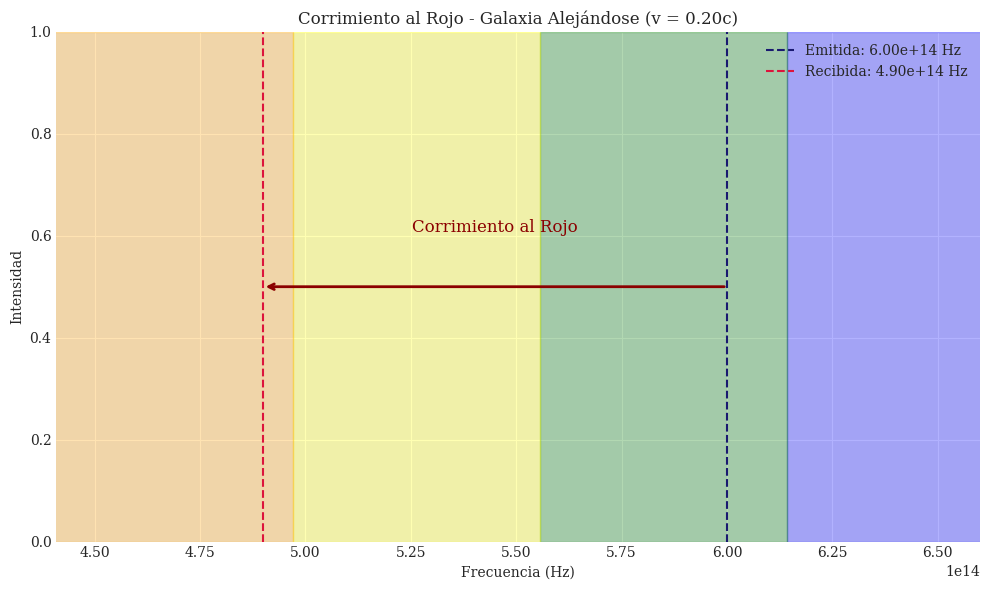

In [13]:
# -------------------------------------------------------------------------------
# EJEMPLO 1: Corrimiento al Rojo en Galaxias Distantes
# -------------------------------------------------------------------------------
# Datos del problema
f_em_1 = 6.0e14  # Hz
v_1 = 0.2 * c    # m/s

#Calcular la frecuencia recibida
factor_doppler_1 = calculo_doppler_relativista(0.2)
f_rec_1 = f_em_1*factor_doppler_1

#Calcular el corrimiento al rojo z
z_1 = (f_em_1 - f_rec_1)/f_rec_1

# Tipo de corrimiento
tipo_corrimiento_1 = "rojo" if f_rec_1 < f_em_1 else "azul"

#Visualizar el corrimiento
fig1, ax1 = visualizar_corrimiento(f_em_1, f_rec_1,"Corrimiento al Rojo - Galaxia Alejándose", velocidad=0.2)

#Agregar una flecha para indicar la dirección del corrimiento
y_pos = 0.5
ax1.annotate('', xy=(f_em_1, y_pos), xytext=(f_rec_1, y_pos),
            arrowprops=dict(arrowstyle='<-', lw=2, color='darkred'))
ax1.text((f_em_1 + f_rec_1)/2, y_pos+0.1, 'Corrimiento al Rojo',
        ha='center', va='bottom', color='darkred', fontsize=12)

plt.tight_layout()
plt.show()

**Ejercicio 1: Corrimiento al rojo en una galaxia distante**

**Situación:**  
Una galaxia lejana emite luz con una frecuencia característica de:

$$
f_{em} = 6.0 \times 10^{14} \, \text{Hz}
$$

Esta galaxia se **aleja** de la Tierra a una velocidad constante de:

$$
V = 0.2c
$$

**Preguntas:**

1. ¿Cuál es la frecuencia recibida por un observador en la Tierra?
2. ¿Cuál es el corrimiento al rojo \( z \)?
3. Interpreta el resultado: ¿la luz se corre al rojo o al azul?

**Resolución:**

Usamos la fórmula del **efecto Doppler relativista**:

$$
f_{rec} = f_{em} \sqrt{\frac{1 - V/c}{1 + V/c}} = 6.0 \times 10^{14} \sqrt{\frac{1 - 0.2}{1 + 0.2}} = 6.0 \times 10^{14} \sqrt{\frac{0.8}{1.2}} \approx 6.0 \times 10^{14} \times 0.816
$$

$$
f_{rec} \approx 4.896 \times 10^{14} \, \text{Hz}
$$

Ahora, calculamos el **corrimiento al rojo**:

$$
z = \frac{f_{em} - f_{rec}}{f_{rec}} = \frac{6.0 - 4.896}{4.896} \approx 0.225
$$

La frecuencia disminuye → la longitud de onda aumenta → **corrimiento al rojo**.  
Esto es evidencia directa de la **expansión del universo**, donde galaxias distantes se alejan y sus espectros se desplazan hacia el rojo.



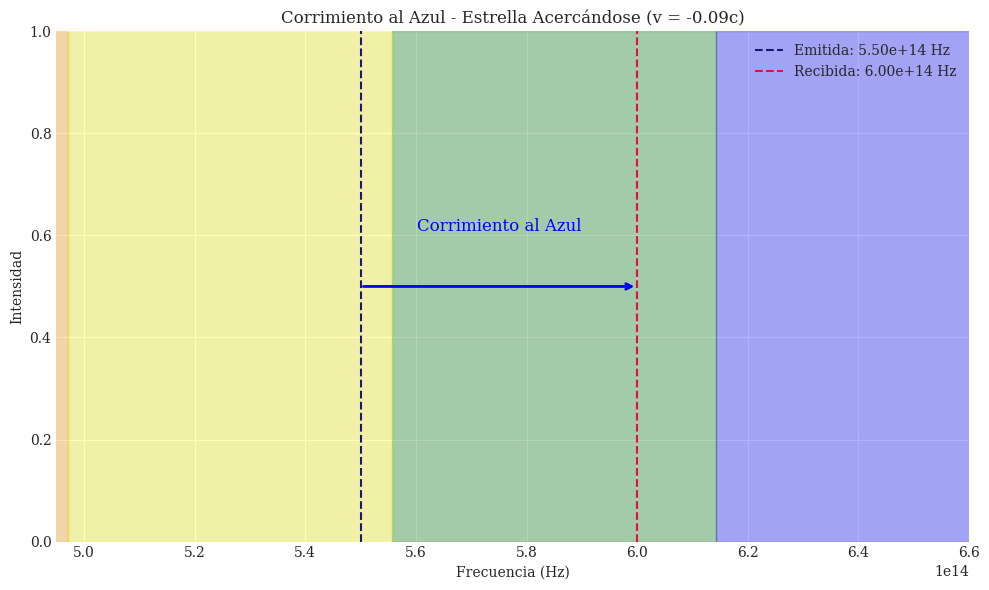

In [14]:
# -------------------------------------------------------------------------------
# EJEMPLO 2: Estrella Acercándose (Corrimiento al Azul)
# -------------------------------------------------------------------------------

# Datos del problema
f_em_2 = 5.5e14  # Hz
f_rec_2 = 6.0e14  # Hz

#Calcular la velocidad de la estrella

ratio_squared = (f_rec_2/f_em_2)**2
# Resolver para v/c
v_c = (1 - ratio_squared)/(1 + ratio_squared)

#Tipo de corrimiento
tipo_corrimiento_2 = "azul" if f_rec_2 > f_em_2 else "rojo"

#Visualizar el corrimiento
fig2, ax2 = visualizar_corrimiento(f_em_2, f_rec_2,
                                "Corrimiento al Azul - Estrella Acercándose",
                                velocidad=v_c)

#Agregar una flecha para indicar la dirección del corrimiento
y_pos = 0.5
ax2.annotate('', xy=(f_em_2, y_pos), xytext=(f_rec_2, y_pos),
            arrowprops=dict(arrowstyle='<-', lw=2, color='blue'))
ax2.text((f_em_2 + f_rec_2)/2, y_pos+0.1, 'Corrimiento al Azul',
        ha='center', va='bottom', color='blue', fontsize=12)

plt.tight_layout()
plt.show()


**Ejercicio 2: Corrimiento al azul de una estrella cercana**

**Situación:**  
Una estrella que se **acerca** a la Tierra emite luz con una frecuencia:

$$
f_{em} = 5.5 \times 10^{14} \, \text{Hz}
$$

El espectroscopio en la Tierra detecta una frecuencia aumentada:

$$
f_{rec} = 6.0 \times 10^{14} \, \text{Hz}
$$

**Preguntas:**

1. ¿Cuál es la velocidad de la estrella?
2. ¿Se trata de un corrimiento al rojo o al azul?

**Resolución:**

Usamos la fórmula inversa del efecto Doppler relativista:

$$
\left(\frac{f_{rec}}{f_{em}}\right)^2 = \frac{1 - V/c}{1 + V/c}
\Rightarrow \left(\frac{6.0}{5.5}\right)^2 = \frac{1 - V/c}{1 + V/c}
\Rightarrow 1.188 \approx \frac{1 - V/c}{1 + V/c}
$$

Resolviendo:

$$
1.188 (1 + V/c) = 1 - V/c
\Rightarrow 1.188 + 1.188 V/c = 1 - V/c
\Rightarrow 2.188 V/c = -0.188
\Rightarrow V/c \approx -0.086
\Rightarrow V \approx -0.086c \approx -2.58 \times 10^7 \, \text{m/s}
$$

El signo negativo indica que la estrella **se acerca** → la frecuencia aumenta → **corrimiento al azul**.  
Esto sucede, por ejemplo, con estrellas en sistemas binarios o cúmulos que orbitan y se mueven en dirección a nosotros.



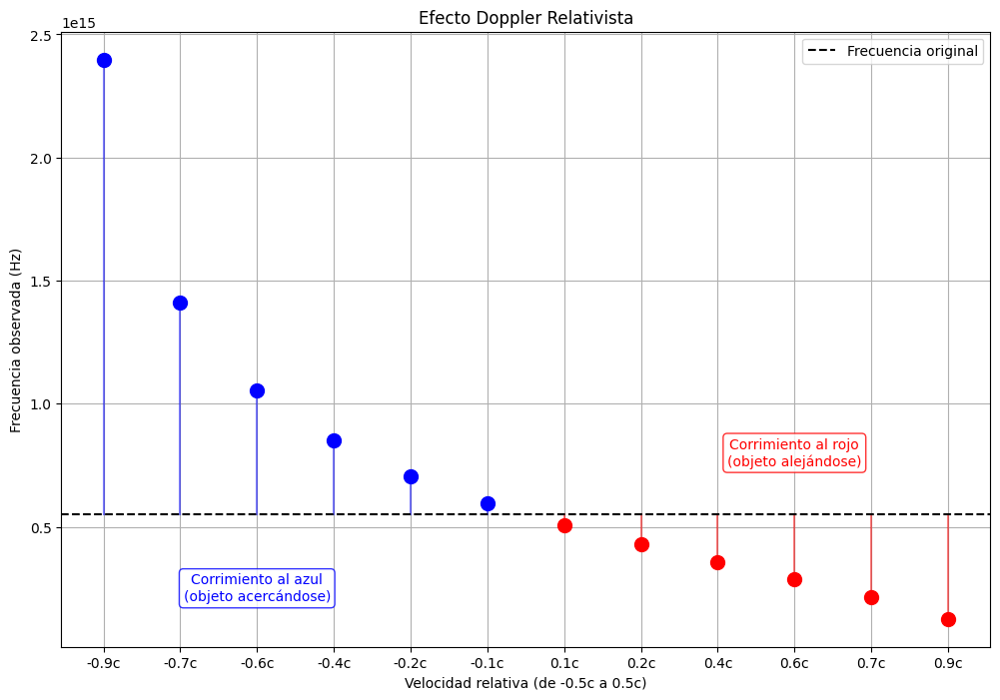

In [9]:
# Función para crear una visualización del corrimiento Doppler a diferentes velocidades
def visualizar_corrimiento_animado():
    """
    Genera una visualización conceptual del efecto Doppler en diferentes velocidades
    """
    velocidades = np.linspace(-0.9, 0.9, 12)  # De -0.5c a 0.5c
    f_original = 5.5e14  # Frecuencia original

    plt.figure(figsize=(12, 8))
    plt.style.use('default')

    for i, v in enumerate(velocidades):
        factor = calculo_doppler_relativista(v)
        f_observada = f_original*factor

        # Calcular z
        if v > 0:  # Alejándose - corrimiento al rojo
            z = (f_original - f_observada) / f_observada
            color = 'red'
            tipo = 'rojo'
        else:  # Acercándose - corrimiento al azul
            z = (f_observada - f_original) / f_original
            color = 'blue'
            tipo = 'azul'

        plt.plot(i, f_observada, 'o', markersize=10, color=color)
        plt.plot([i, i], [f_original, f_observada], '-', color=color, alpha=0.5)

    plt.axhline(y=f_original, color='black', linestyle='--', label='Frecuencia original')

    plt.title('Efecto Doppler Relativista')
    plt.xlabel('Velocidad relativa (de -0.5c a 0.5c)')
    plt.ylabel('Frecuencia observada (Hz)')
    plt.xticks(range(12), [f'{v:.1f}c' for v in velocidades])
    plt.grid()
    plt.legend()

    # Agregar etiquetas explicativas
    plt.annotate('Corrimiento al azul\n(objeto acercándose)', xy=(2, 7e14),
                xytext=(2, 2.5e14), ha='center', va='center', color='blue',
                bbox=dict(boxstyle="round", fc="white", ec="blue", alpha=0.8))

    plt.annotate('Corrimiento al rojo\n(objeto alejándose)', xy=(8, 4e14),
                xytext=(9, 8e14), ha='center', va='center', color='red',
                bbox=dict(boxstyle="round", fc="white", ec="red", alpha=0.8))

    plt.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

    plt.show()

# Crear la visualización
visualizar_corrimiento_animado()

## 1.3.5 La velocidad de Transformación

La **transformación de velocidades** en relatividad especial modifica las ecuaciones clásicas para garantizar la constancia de la velocidad de la luz ($c$) en todos los marcos inerciales.

Partiendo de las **transformaciones de Lorentz** para intervalos espaciotemporales entre dos eventos en marcos $S$ y $S'$ (en configuración estándar):  
$$
\Delta t' = \gamma(V) \left( \Delta t - \frac{V \Delta x}{c^2} \right),
$$  
$$
\Delta x' = \gamma(V) (\Delta x - V \Delta t),
$$  

Primero partimos encontrando la relación de las velocidades al dividir $\Delta x'$ entre $\Delta t'$, se obtiene la velocidad en $S'$:  

  $$
  v'_x = \frac{\Delta x'}{\Delta t'} = \frac{\Delta x - V \Delta t}{\Delta t - \frac{V \Delta x}{c^2}}.
  $$  

Luego, si los eventos son cercanos ($\Delta t \to 0$, $\Delta x \to 0$), $\frac{\Delta x}{\Delta t}$ y $\frac{\Delta x'}{\Delta t'}$ se convierten en velocidades instantáneas $v_x$ y $v'_x$. *Así*, la componente $x$ se transforma como:  

  $$
  v'_x = \frac{v_x - V}{1 - \frac{v_x V}{c^2}}
  $$  

Por ultimo, para velocidades en $y$ y $z$, la contracción de Lorentz y la dilatación temporal modifican las componentes:  

  $$
  v'_y = \frac{v_y}{\gamma(V) \left(1 - \frac{v_x V}{c^2}\right)}
  $$  

  $$
  v'_z = \frac{v_z}{\gamma(V) \left(1 - \frac{v_x V}{c^2}\right)}
  $$


Ahora, podemos poner a prueba estas ecuaciones bajo las siguientes condiciones para ver si son consistentes con la relatividad especial:

* **Bajas velocidades ($v \ll c$):**  
  El término $\frac{v_x V}{c^2}$ es despreciable, y $\gamma(V) \approx 1$. Por lo tanto, las ecuaciones se reducen a la **transformación galileana**:  
  $$
  v'_x \approx v_x - V, \quad v'_y \approx v_y, \quad v'_z \approx v_z.
  $$  

- **Altas velocidades ($v \sim c$):**  
  El denominador $1 - \frac{v_x V}{c^2}$ asegura que $v'_x$ nunca supere $c$. Por ejemplo, si un objeto se mueve a $v_x = c$ en $S$, en $S'$:  

  $$
  v'_x = \frac{c - V}{1 - \frac{c V}{c^2}} = c.
  $$  
  
  Esto confirma el segundo postulado de Einstein: $c$ es invariante.  




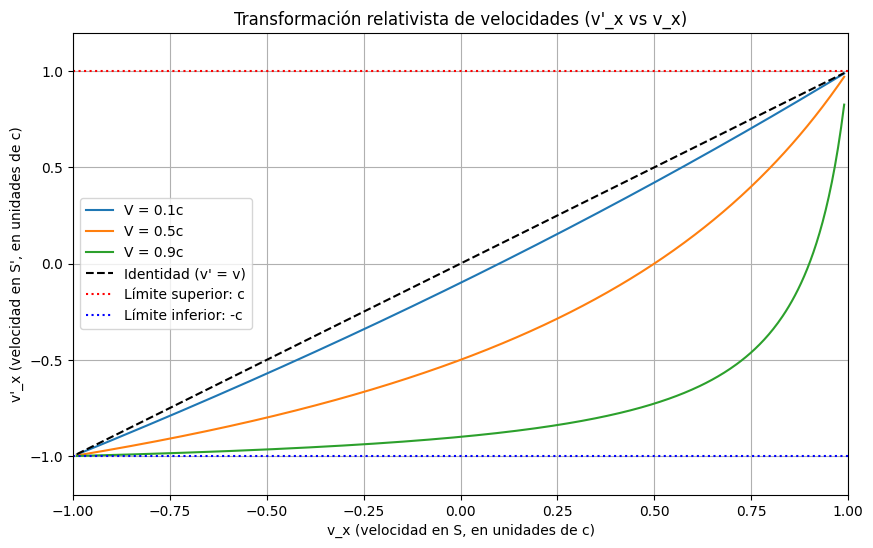

In [10]:
# Valores de V en unidades de c
V_vals = [0.1, 0.5, 0.9]
c = 1  # trabajamos en unidades naturales donde c = 1

# Rango de velocidades en S (desde -c hasta c)
v_x = np.linspace(-0.99, 0.99, 500)

plt.figure(figsize=(10, 6))
plt.style.use('default')

for V in V_vals:
    v_x_prime = (v_x - V) / ((1 - v_x*V)/c**2)
    plt.plot(v_x, v_x_prime, label=f"V = {V}c")

# Línea de identidad para comparar (clásico)
plt.plot(v_x, v_x, 'k--', label="Identidad (v' = v)")

# Límites visuales
plt.axhline(1, color='red', linestyle=':', label='Límite superior: c')
plt.axhline(-1, color='blue', linestyle=':', label='Límite inferior: -c')

plt.title("Transformación relativista de velocidades (v'_x vs v_x)")
plt.xlabel("v_x (velocidad en S, en unidades de c)")
plt.ylabel("v'_x (velocidad en S', en unidades de c)")
plt.grid()
plt.legend()
plt.ylim(-1.2, 1.2)
plt.xlim(-1, 1)
plt.show()
